<a href="https://colab.research.google.com/github/patrickdevv/FIAP_Hackathon_fase05/blob/main/Desafio_Fase_05.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Desafio da Fase 05 - IA para Devs

Objetivos
*   Construir ou buscar um dataset contendo imagens de facas, tesouras e outros objetos cortantes em diferentes condições de ângulo e iluminação;
*   Anotar o dataset para treinar o modelo supervisionado, incluindo imagens negativas (sem objetos perigosos) para reduzir falsos positivos;
*   Treinar o modelo;
*   Desenvolver um sistema de alertas (pode ser um e-mail).

# Instalação de dependências

In [1]:

!pip install ultralytics roboflow opencv-python-headless --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 978.8/978.8 kB 59.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.2/85.2 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 45.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 136.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 131.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 103.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 59.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 40.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1

# Baixar dataset do Roboflow

In [2]:
from roboflow import Roboflow

rf = Roboflow(api_key="hApyf07gICxTJlulxK5j")
project = rf.workspace("fiap-cxe1i").project("desafio-fase-05")
dataset = project.version(1).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Desafio-Fase-05-1 in yolov8:: 100%|██████████| 1732/1732 [00:00<00:00, 7677.82it/s]


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


## Definir data.yaml

In [3]:
import os
dataset_name = dataset.location.split('/')[-1]
yaml_path = "/content/data.yaml"

with open(yaml_path, "w") as f:
    f.write(f"""train: /content/{dataset_name}/train/images
val: /content/{dataset_name}/valid/images
nc: 3
names: ['faca', 'tesoura', 'objeto_cortante_outro']
""")

print(f"Arquivo criado em: {yaml_path}")


Arquivo criado em: /content/data.yaml


## Treinar modelo Yolo

In [4]:
from ultralytics import YOLO

model = YOLO('yolov8n.pt')
model.train(data='data.yaml', epochs=20, imgsz=640)


100%|██████████| 6.25M/6.25M [00:00<00:00, 343MB/s]


Ultralytics 8.3.111 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None

100%|██████████| 755k/755k [00:00<00:00, 118MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 373MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1350.9±577.2 MB/s, size: 65.3 KB)


train: Scanning /content/Desafio-Fase-05-1/train/labels... 748 images, 1 backgrounds, 0 corrupt: 100%|██████████| 748/748 [00:00<00:00, 1488.63it/s]


train: New cache created: /content/Desafio-Fase-05-1/train/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 104, len(boxes) = 1046. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 592.8±332.8 MB/s, size: 59.7 KB)


val: Scanning /content/Desafio-Fase-05-1/valid/labels... 74 images, 0 backgrounds, 0 corrupt: 100%|██████████| 74/74 [00:00<00:00, 1353.71it/s]

val: New cache created: /content/Desafio-Fase-05-1/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20       2.1G      1.296      2.793       1.61         35        640: 100%|██████████| 47/47 [00:05<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.16it/s]

                   all         74        101      0.231     0.0985      0.177      0.079



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.64G      1.343      2.332      1.618         47        640: 100%|██████████| 47/47 [00:04<00:00, 11.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  8.69it/s]

                   all         74        101      0.242      0.281       0.17     0.0784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.65G      1.407      2.222      1.658         26        640: 100%|██████████| 47/47 [00:04<00:00, 11.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  8.90it/s]


                   all         74        101      0.116      0.215      0.103     0.0452

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.67G      1.446      2.192      1.685         39        640: 100%|██████████| 47/47 [00:04<00:00, 11.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  8.64it/s]

                   all         74        101      0.261      0.264        0.2     0.0735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.69G       1.43      2.139      1.681         28        640: 100%|██████████| 47/47 [00:04<00:00, 11.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.47it/s]

                   all         74        101      0.298      0.316      0.274      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      2.71G      1.375      1.995      1.639         34        640: 100%|██████████| 47/47 [00:04<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  8.97it/s]

                   all         74        101        0.3      0.524      0.266      0.121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.72G      1.313      1.865      1.605         23        640: 100%|██████████| 47/47 [00:04<00:00, 11.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  8.99it/s]

                   all         74        101      0.329      0.401      0.273      0.133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.74G      1.311      1.825      1.596         31        640: 100%|██████████| 47/47 [00:04<00:00, 11.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.37it/s]


                   all         74        101      0.467      0.407      0.439       0.26

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.76G      1.253      1.698      1.564         49        640: 100%|██████████| 47/47 [00:04<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.15it/s]


                   all         74        101      0.465      0.449      0.475      0.269

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.77G      1.233      1.643      1.526         43        640: 100%|██████████| 47/47 [00:04<00:00, 11.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.87it/s]

                   all         74        101        0.6      0.568       0.51      0.308


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      2.79G      1.216      1.654       1.64         15        640: 100%|██████████| 47/47 [00:04<00:00, 10.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.09it/s]


                   all         74        101      0.681      0.382      0.492      0.307

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.81G      1.162      1.536      1.577         11        640: 100%|██████████| 47/47 [00:04<00:00, 11.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.79it/s]

                   all         74        101      0.654      0.448      0.532      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.82G      1.141      1.495      1.556         13        640: 100%|██████████| 47/47 [00:03<00:00, 11.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.43it/s]


                   all         74        101      0.594      0.496      0.572       0.37

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.84G      1.082      1.394      1.516         20        640: 100%|██████████| 47/47 [00:03<00:00, 11.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  8.93it/s]

                   all         74        101       0.65      0.596      0.631       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.86G      1.026      1.275      1.467         14        640: 100%|██████████| 47/47 [00:03<00:00, 12.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.68it/s]

                   all         74        101      0.569      0.659      0.634      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.88G     0.9811      1.219      1.407         15        640: 100%|██████████| 47/47 [00:04<00:00, 11.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.63it/s]

                   all         74        101      0.694      0.532        0.6      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.89G     0.9654      1.126      1.406         12        640: 100%|██████████| 47/47 [00:04<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.10it/s]


                   all         74        101      0.794      0.536      0.666      0.463

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.91G     0.8991      1.058      1.355         16        640: 100%|██████████| 47/47 [00:03<00:00, 11.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.19it/s]

                   all         74        101      0.643      0.526      0.616      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.93G     0.8844       0.99      1.343         17        640: 100%|██████████| 47/47 [00:03<00:00, 11.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.57it/s]

                   all         74        101      0.773      0.523       0.64      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.95G     0.8591     0.9881      1.319         28        640: 100%|██████████| 47/47 [00:04<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.83it/s]

                   all         74        101      0.832      0.494      0.663      0.457



20 epochs completed in 0.027 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.111 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
Model summary (fused): 72 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.10it/s]


                   all         74        101      0.794      0.536      0.666      0.462
                  faca         14         22      0.687        0.5      0.533      0.337
               tesoura         61         79        0.9      0.572      0.798      0.588
Speed: 0.1ms preprocess, 0.5ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b65870da150>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

## Upload do video de teste

In [5]:
from google.colab import files

uploaded = files.upload()
video_path = list(uploaded.keys())[0]


Saving video2.mp4 to video2.mp4


## Preparação para envio de mensagem no Telegram

In [18]:
import time
import requests

TELEGRAM_TOKEN = '8116657968:AAHqAR6UTAN8zfOIy5ZybSmhPZGCszgnCiY'
TELEGRAM_CHAT_ID = '9460582'

def enviar_telegram(mensagem, delay=1):
    url = f"https://api.telegram.org/bot{TELEGRAM_TOKEN}/sendMessage"
    data = {"chat_id": TELEGRAM_CHAT_ID, "text": mensagem}
    try:
        response = requests.post(url, data=data)
        if response.status_code == 200:
            print(f"✅ Alerta enviado: {mensagem}")
        else:
            print(f"❌ Falha ao enviar: {response.status_code} - {response.text}")
    except Exception as e:
        print(f"⚠️ Erro no envio do Telegram: {e}")
    time.sleep(delay)  # delay após o envio



## Excecução com envio de alerta


0: 384x640 1 faca, 8.5ms
Speed: 1.9ms preprocess, 8.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


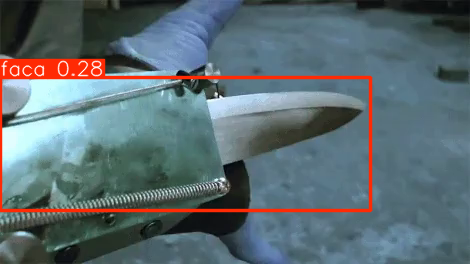

✅ Alerta enviado: ⚠️ Frame 0: faca detectado com 28.3% de confiança

0: 384x640 (no detections), 8.3ms
Speed: 2.1ms preprocess, 8.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.0ms
Speed: 2.6ms preprocess, 8.0ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.5ms
Speed: 1.7ms preprocess, 7.5ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.4ms
Speed: 1.7ms preprocess, 7.4ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 faca, 7.3ms
Speed: 1.7ms preprocess, 7.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 5: faca detectado com 45.8% de confiança

0: 384x640 (no detections), 8.3ms
Speed: 2.1ms preprocess, 8.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.7ms
Speed: 1.8ms preprocess, 7.7ms inference, 0.6ms post

In [20]:
import cv2
from IPython.display import display
import PIL.Image

model = YOLO('runs/detect/train/weights/best.pt')
cap = cv2.VideoCapture(video_path)

fps = cap.get(cv2.CAP_PROP_FPS)
width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

output_path = "output_detectado.mp4"
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

contagem = {
    'faca': 0,
    'tesoura': 0,
    'objeto_cortante_outro': 0
}

id_para_nome = {
    0: 'faca',
    1: 'tesoura',
    2: 'objeto_cortante_outro'
}

frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    results = model(frame)
    annotated_frame = results[0].plot()
    out.write(annotated_frame)

    if frame_count % 60 == 0:
        display(PIL.Image.fromarray(annotated_frame))

    for box in results[0].boxes:
        cls = int(box.cls[0].item())
        nome = id_para_nome.get(cls, "desconhecido")
        score = float(box.conf[0]) * 100

        contagem[nome] += 1

        mensagem = f"⚠️ Frame {frame_count}: {nome} detectado com {score:.1f}% de confiança"
        enviar_telegram(mensagem)

    frame_count += 1

cap.release()
out.release()
print(f"✅ Vídeo gerado em: {output_path}")

# 📊 Mostrar resumo ao final
print("\n📊 RESUMO DAS DETECÇÕES:")
for classe, total in contagem.items():
    print(f"🗂️ {classe.capitalize()}: {total} detecções")

resumo = "\n".join([f"• {classe}: {total}" for classe, total in contagem.items()])
mensagem_final = f"📊 Resumo VisionGuard:\n{resumo}"
enviar_telegram(mensagem_final)



## Upload do arquivo 02

In [8]:
from google.colab import files

uploaded = files.upload()
video2_path = list(uploaded.keys())[0]


Saving video.mp4 to video.mp4


## Execução para Video 02


0: 384x640 (no detections), 8.6ms
Speed: 2.5ms preprocess, 8.6ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


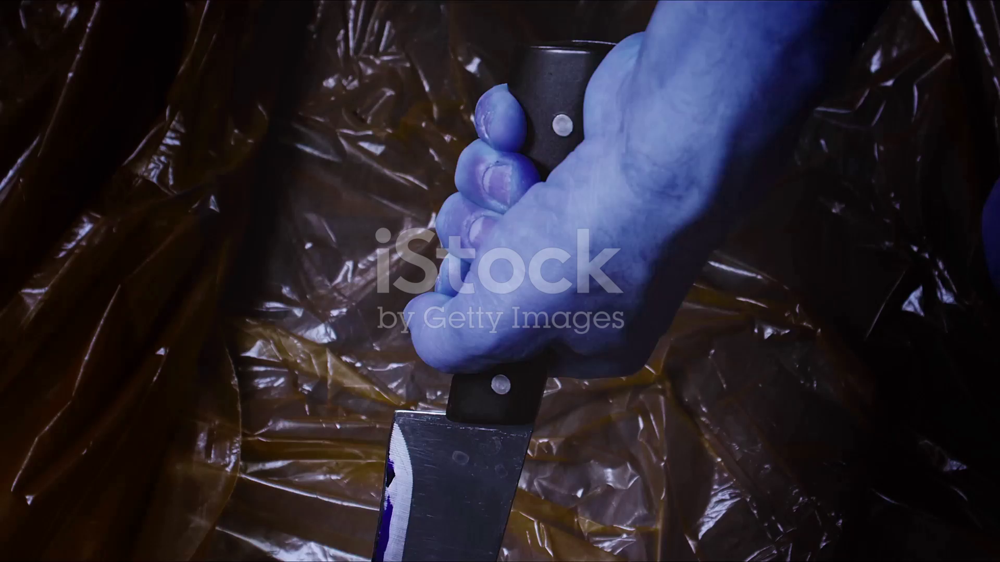


0: 384x640 (no detections), 8.8ms
Speed: 2.5ms preprocess, 8.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.6ms
Speed: 2.5ms preprocess, 8.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.2ms
Speed: 2.6ms preprocess, 10.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.2ms
Speed: 2.4ms preprocess, 8.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.4ms
Speed: 2.6ms preprocess, 8.4ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.3ms
Speed: 3.7ms preprocess, 11.3ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.1ms
Speed: 2.4ms preprocess, 8.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.3ms
Speed: 2.5ms preprocess, 8.3ms inference, 0.

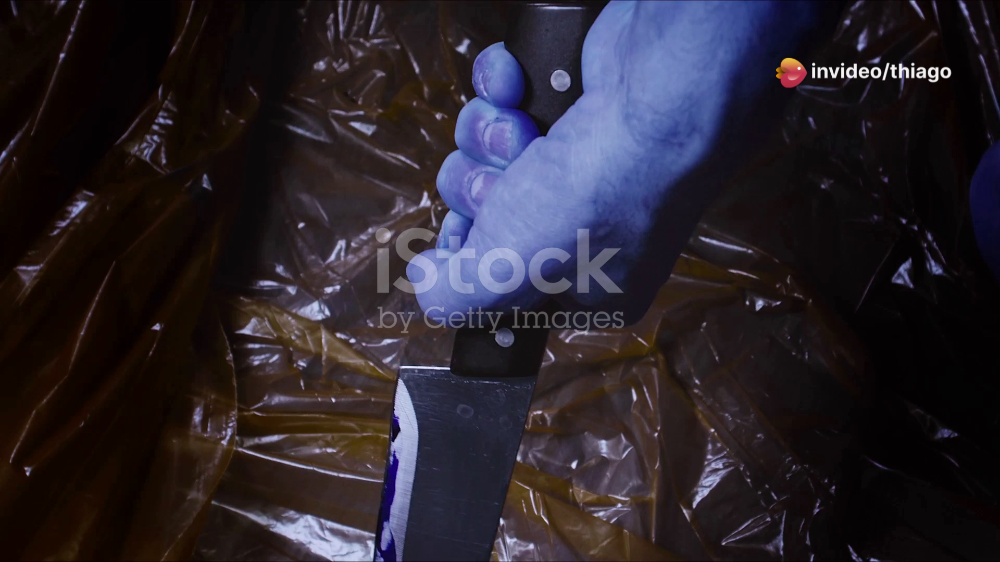


0: 384x640 (no detections), 9.1ms
Speed: 2.6ms preprocess, 9.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 9.0ms
Speed: 2.5ms preprocess, 9.0ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.3ms
Speed: 2.4ms preprocess, 8.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.3ms
Speed: 2.7ms preprocess, 8.3ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.2ms
Speed: 2.5ms preprocess, 8.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.7ms
Speed: 2.4ms preprocess, 8.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.8ms
Speed: 2.5ms preprocess, 8.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.1ms
Speed: 2.5ms preprocess, 8.1ms inference, 0.7ms 

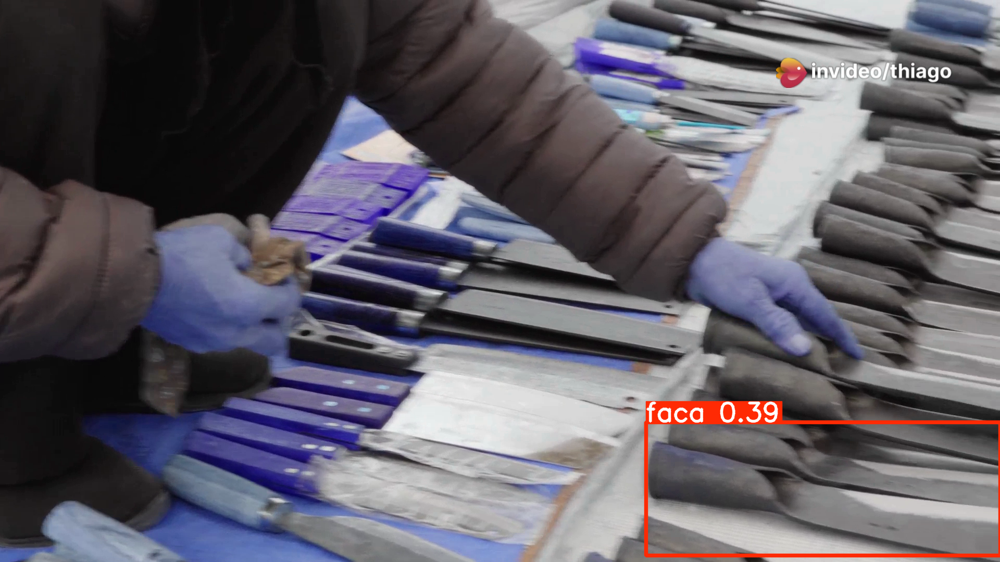

✅ Alerta enviado: ⚠️ Frame 120: faca detectado com 39.0% de confiança

0: 384x640 1 faca, 9.6ms
Speed: 3.7ms preprocess, 9.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 121: faca detectado com 27.4% de confiança

0: 384x640 1 faca, 8.2ms
Speed: 2.5ms preprocess, 8.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 122: faca detectado com 34.6% de confiança

0: 384x640 2 facas, 10.9ms
Speed: 3.7ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 123: faca detectado com 31.6% de confiança
✅ Alerta enviado: ⚠️ Frame 123: faca detectado com 26.7% de confiança

0: 384x640 1 faca, 8.6ms
Speed: 2.6ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 124: faca detectado com 27.0% de confiança

0: 384x640 1 faca, 10.7ms
Speed: 3.2ms preprocess, 10.7ms inference, 1.7ms postprocess p

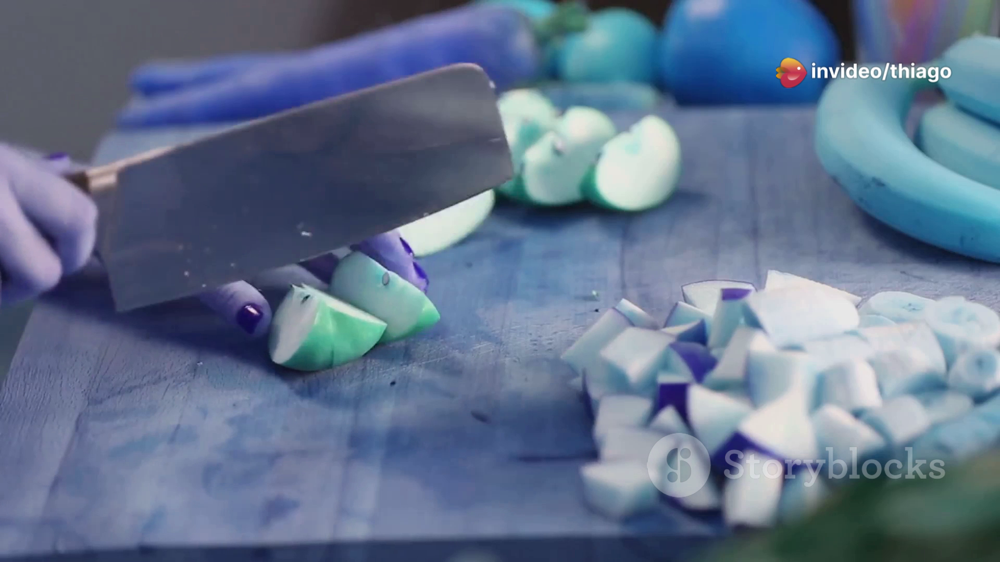


0: 384x640 (no detections), 8.1ms
Speed: 2.3ms preprocess, 8.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 faca, 8.3ms
Speed: 2.4ms preprocess, 8.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 182: faca detectado com 33.0% de confiança

0: 384x640 (no detections), 10.6ms
Speed: 4.1ms preprocess, 10.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.8ms
Speed: 2.5ms preprocess, 7.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.3ms
Speed: 3.7ms preprocess, 10.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.2ms
Speed: 2.4ms preprocess, 8.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.5ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no de

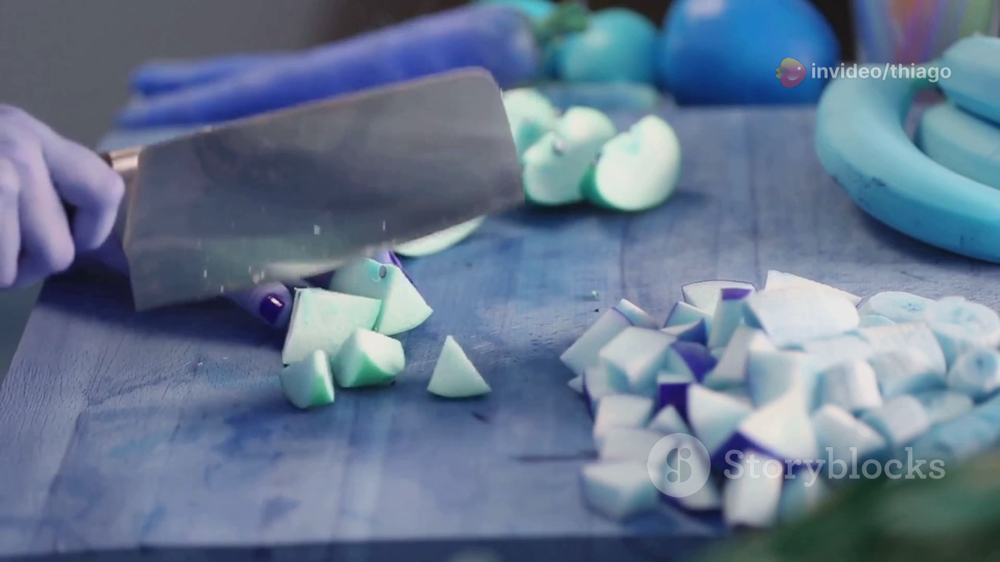


0: 384x640 (no detections), 8.6ms
Speed: 2.4ms preprocess, 8.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.3ms
Speed: 2.6ms preprocess, 8.3ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.5ms
Speed: 2.2ms preprocess, 7.5ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.8ms
Speed: 2.3ms preprocess, 7.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.0ms
Speed: 3.6ms preprocess, 11.0ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.7ms
Speed: 2.3ms preprocess, 7.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.8ms
Speed: 2.4ms preprocess, 7.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.3ms preprocess, 7.9ms inference, 0.6m

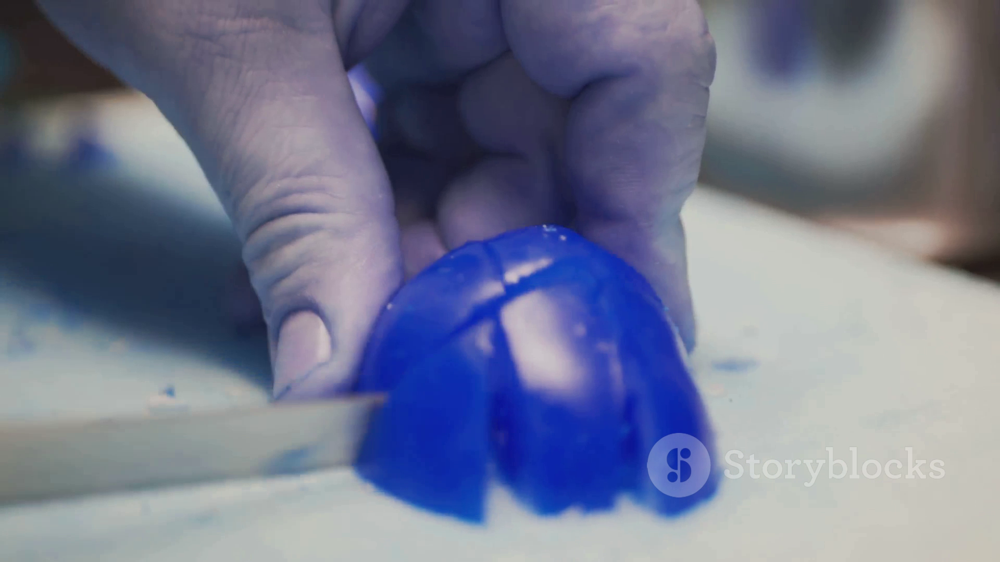


0: 384x640 (no detections), 8.2ms
Speed: 2.5ms preprocess, 8.2ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.0ms
Speed: 2.5ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.0ms
Speed: 3.7ms preprocess, 11.0ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.8ms
Speed: 2.3ms preprocess, 7.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.7ms
Speed: 2.3ms preprocess, 7.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.8ms
Speed: 2.3ms preprocess, 7.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.1ms
Speed: 3.7ms preprocess, 11.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.7ms
Speed: 2.2ms preprocess, 7.7ms inference, 0.

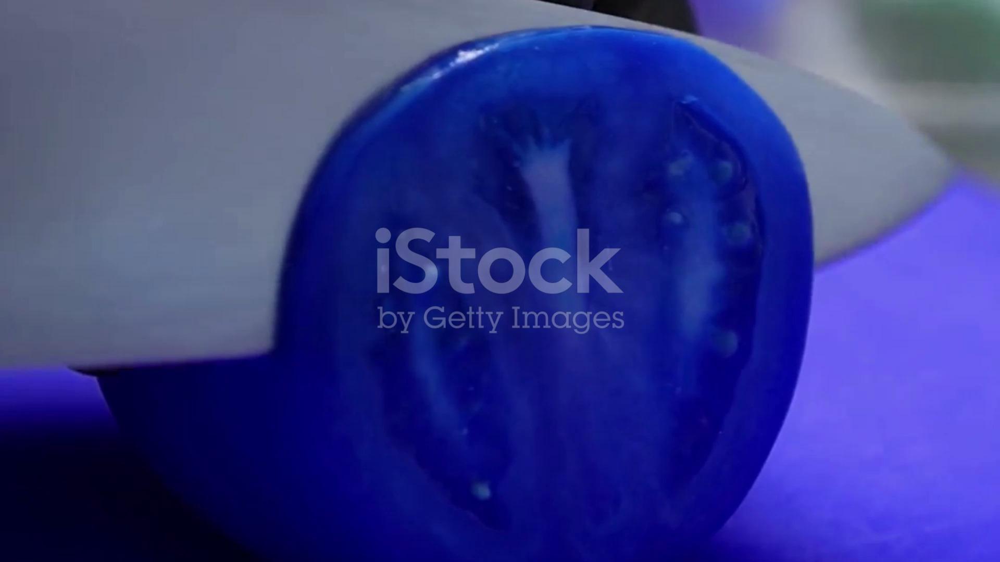


0: 384x640 (no detections), 8.2ms
Speed: 2.4ms preprocess, 8.2ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.5ms preprocess, 7.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.8ms
Speed: 2.3ms preprocess, 7.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.3ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.7ms
Speed: 2.3ms preprocess, 7.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.6ms
Speed: 3.7ms preprocess, 11.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.9ms
Speed: 2.3ms preprocess, 8.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.8ms
Speed: 2.3ms preprocess, 7.8ms inference, 0.6m

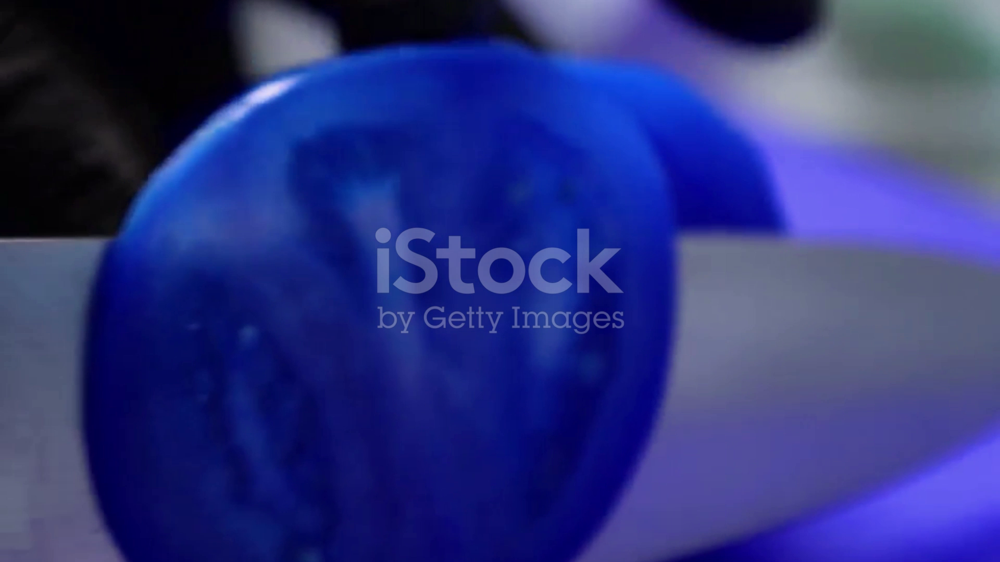


0: 384x640 (no detections), 8.4ms
Speed: 2.3ms preprocess, 8.4ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.0ms
Speed: 2.7ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.0ms
Speed: 3.6ms preprocess, 11.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.7ms
Speed: 2.3ms preprocess, 7.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.6ms
Speed: 2.3ms preprocess, 7.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.6ms
Speed: 2.3ms preprocess, 7.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.6ms
Speed: 2.2ms preprocess, 7.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.6ms
Speed: 2.3ms preprocess, 7.6ms inference, 0.7m

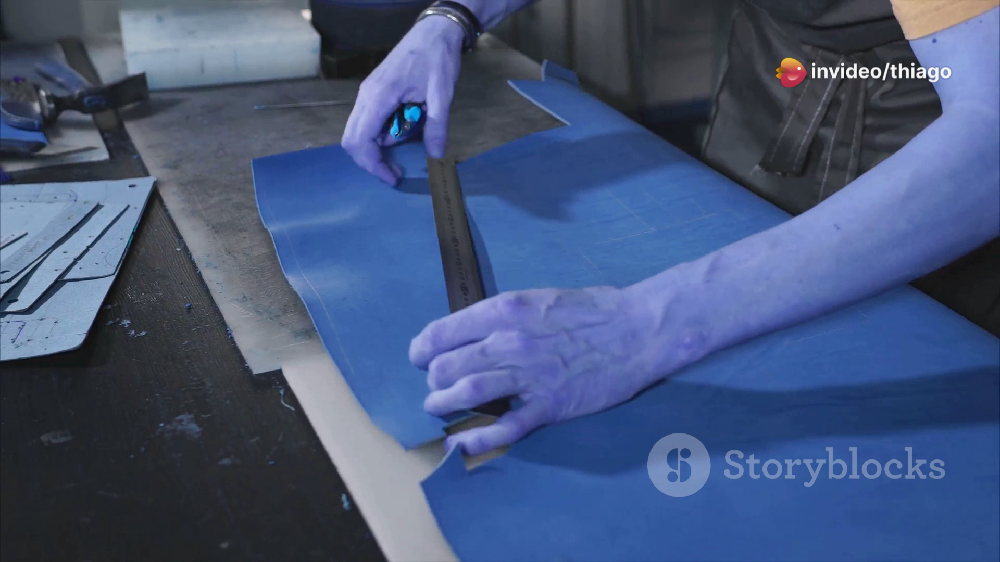


0: 384x640 (no detections), 8.0ms
Speed: 2.4ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 faca, 8.0ms
Speed: 2.5ms preprocess, 8.0ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 482: faca detectado com 41.0% de confiança

0: 384x640 1 faca, 8.0ms
Speed: 2.5ms preprocess, 8.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 483: faca detectado com 33.3% de confiança

0: 384x640 1 faca, 9.7ms
Speed: 2.6ms preprocess, 9.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 484: faca detectado com 27.2% de confiança

0: 384x640 1 faca, 8.7ms
Speed: 2.5ms preprocess, 8.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 485: faca detectado com 38.8% de confiança

0: 384x640 1 faca, 8.9ms
Speed: 3.7ms preprocess, 8.9ms inference, 1.8ms postprocess per image at sh

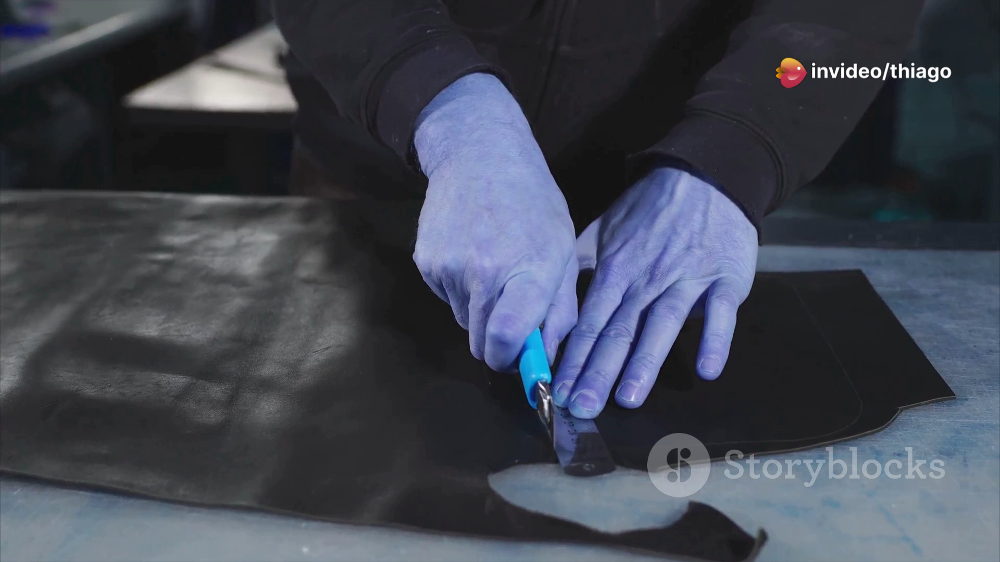


0: 384x640 (no detections), 8.5ms
Speed: 2.4ms preprocess, 8.5ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.1ms
Speed: 2.3ms preprocess, 8.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.5ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.1ms
Speed: 2.4ms preprocess, 8.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.1ms
Speed: 2.4ms preprocess, 8.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.2ms
Speed: 2.5ms preprocess, 8.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.5ms
Speed: 2.5ms preprocess, 8.5ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.1ms
Speed: 2.3ms preprocess, 8.1ms inference, 0.6ms 

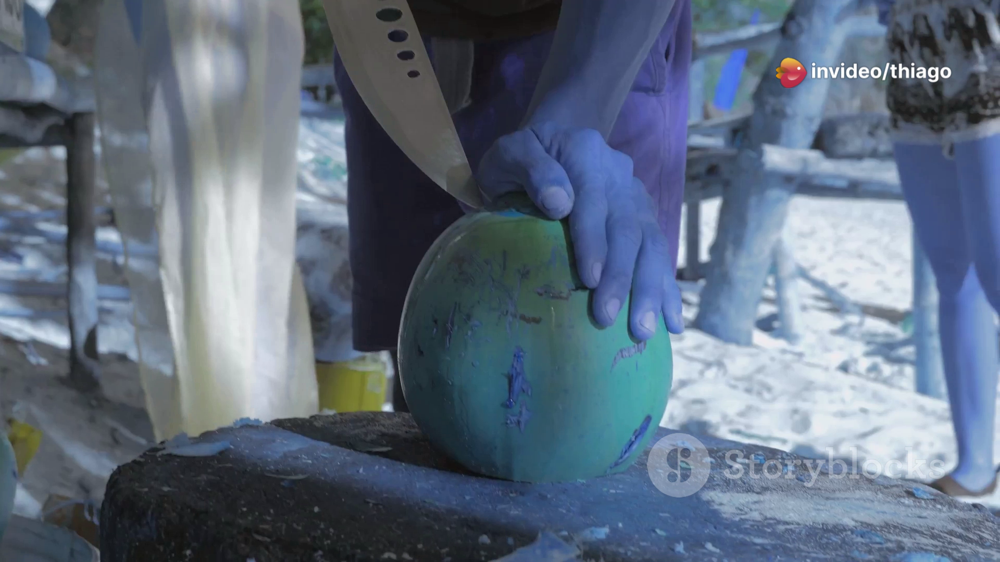


0: 384x640 (no detections), 8.4ms
Speed: 2.4ms preprocess, 8.4ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 9.5ms
Speed: 2.5ms preprocess, 9.5ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.9ms
Speed: 3.6ms preprocess, 10.9ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.7ms
Speed: 2.4ms preprocess, 7.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.4ms preprocess, 7.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 faca, 7.7ms
Speed: 2.3ms preprocess, 7.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 606: faca detectado com 26.6% de confiança

0: 384x640 1 faca, 7.9ms
Speed: 2.6ms preprocess, 7.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
✅ Alerta enviado: ⚠️ Frame 60

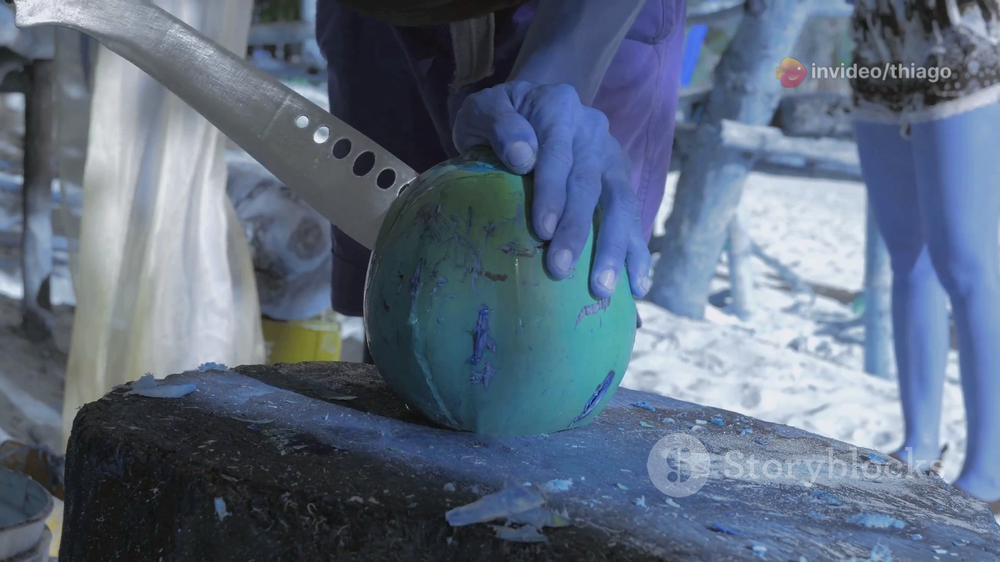


0: 384x640 (no detections), 8.3ms
Speed: 2.5ms preprocess, 8.3ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.0ms
Speed: 2.4ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.1ms
Speed: 2.5ms preprocess, 8.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.0ms
Speed: 2.5ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.8ms
Speed: 2.7ms preprocess, 7.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.2ms
Speed: 2.4ms preprocess, 8.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.0ms
Speed: 2.5ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.8ms
Speed: 3.1ms preprocess, 8.8ms inference, 0.7ms 

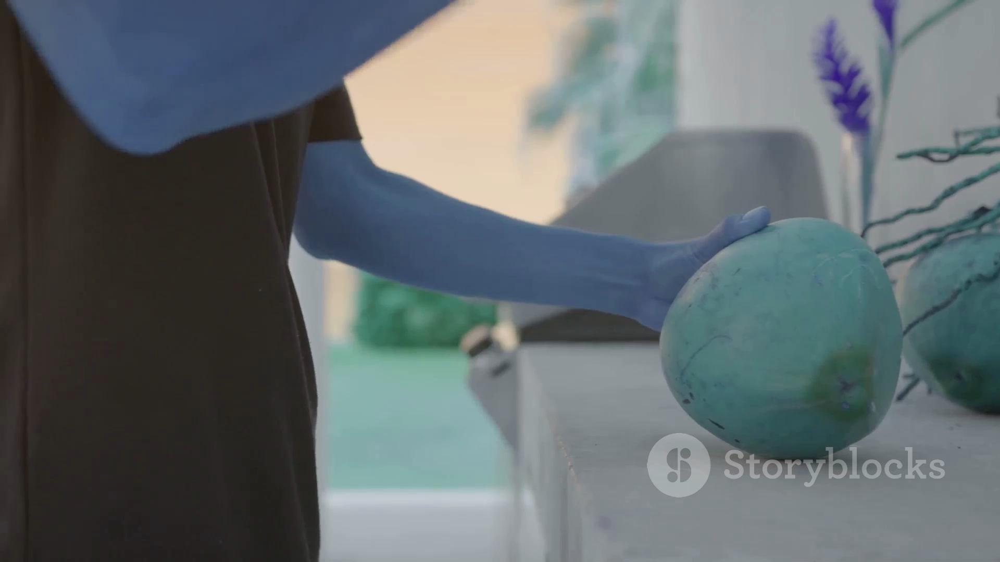


0: 384x640 (no detections), 8.9ms
Speed: 2.4ms preprocess, 8.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.4ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.1ms
Speed: 2.4ms preprocess, 8.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.4ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 9.8ms
Speed: 3.7ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.5ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.0ms
Speed: 2.4ms preprocess, 8.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.1ms
Speed: 2.4ms preprocess, 8.1ms inference, 0.6ms 

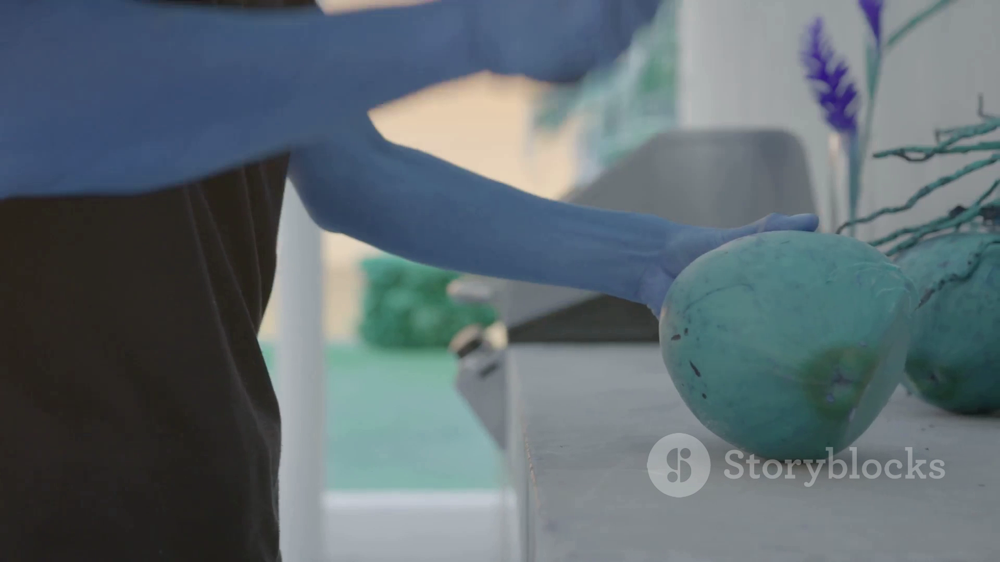


0: 384x640 (no detections), 10.3ms
Speed: 3.8ms preprocess, 10.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.9ms
Speed: 2.5ms preprocess, 8.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.4ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.4ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.7ms
Speed: 2.4ms preprocess, 7.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.1ms
Speed: 3.6ms preprocess, 11.1ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.5ms preprocess, 7.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 2.4ms preprocess, 7.9ms inference, 0.

In [ ]:
import cv2
from IPython.display import display
import PIL.Image

model = YOLO('runs/detect/train/weights/best.pt')
cap2 = cv2.VideoCapture(video2_path)

fps = cap2.get(cv2.CAP_PROP_FPS)
width  = int(cap2.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap2.get(cv2.CAP_PROP_FRAME_HEIGHT))

output_path = "output_video02_detectado.mp4"
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

contagem = {
    'faca': 0,
    'tesoura': 0,
    'objeto_cortante_outro': 0
}

id_para_nome = {
    0: 'faca',
    1: 'tesoura',
    2: 'objeto_cortante_outro'
}

frame_count = 0

while cap2.isOpened():
    ret, frame = cap2.read()
    if not ret:
        break

    results = model(frame)
    annotated_frame = results[0].plot()
    out.write(annotated_frame)

    if frame_count % 60 == 0:
        display(PIL.Image.fromarray(annotated_frame))

    for box in results[0].boxes:
        cls = int(box.cls[0].item())
        nome = id_para_nome.get(cls, "desconhecido")
        score = float(box.conf[0]) * 100

        contagem[nome] += 1

        mensagem = f"⚠️ Frame {frame_count}: {nome} detectado com {score:.1f}% de confiança"
        enviar_telegram(mensagem)

    frame_count += 1

cap2.release()
out.release()
print(f"✅ Vídeo gerado em: {output_path}")

# 📊 Mostrar resumo ao final
print("\n📊 RESUMO DAS DETECÇÕES:")
for classe, total in contagem.items():
    print(f"🗂️ {classe.capitalize()}: {total} detecções")

resumo = "\n".join([f"• {classe}: {total}" for classe, total in contagem.items()])
mensagem_final = f"📊 Resumo VisionGuard:\n{resumo}"
enviar_telegram(mensagem_final)
